In [ ]:
import sys
import os
import warnings
from roboflow import Roboflow
import random
from glob import glob
import cv2
import matplotlib.pyplot as plt
import shutil
import yaml
import albumentations as A
from ultralytics import YOLO
from transformers import CLIPModel, CLIPProcessor
import torch
import numpy as np
from PIL import Image

sys.stderr = sys.stdout
os.environ["TOKENIZERS_PARALLELISM"] = "false"
warnings.filterwarnings("ignore")

### Loading DataSet for Forest Fire

In [94]:
!pip install roboflow


rf = Roboflow(api_key="bFCeZjvdm1jyeb9ud2ak")

project = rf.workspace("situational-awarnessinnovsense").project("fire-detection-ypseh")

dataset = project.version(1).download("yolov5")  

loading Roboflow workspace...
loading Roboflow project...


### Saving and Displaying Images


Processing /kaggle/working/Fire-Detection-1/train - Found 7673 images, sampling 7673
Saved sampled dataset to /kaggle/working/Fire-Detection-1/train_sampled
Displaying 5 samples:


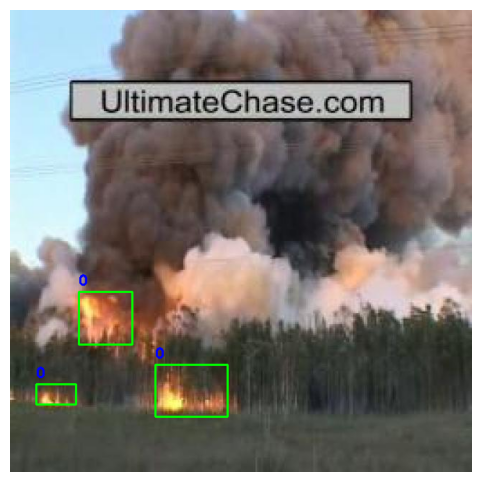

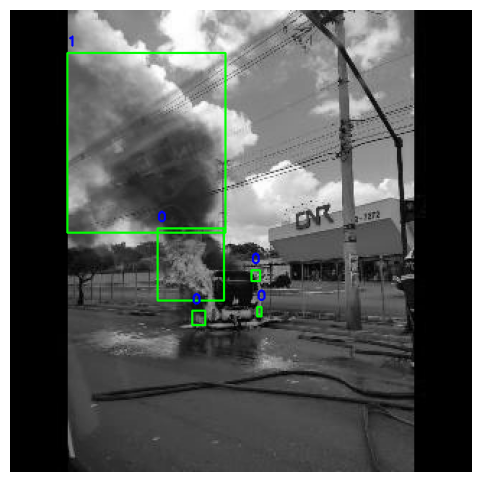

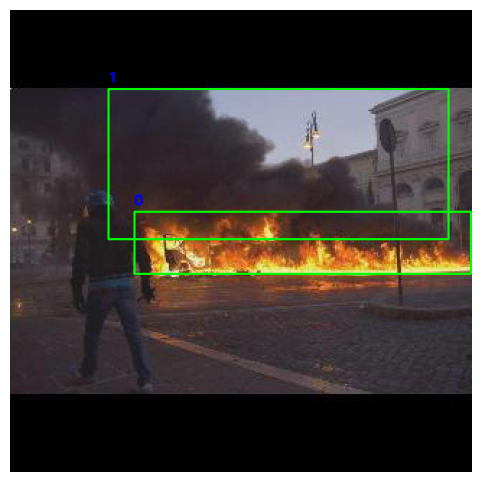

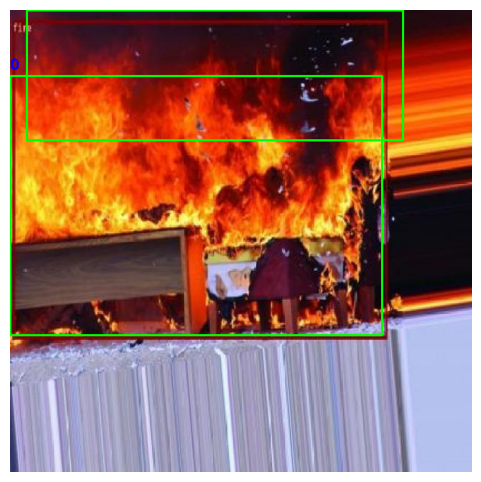

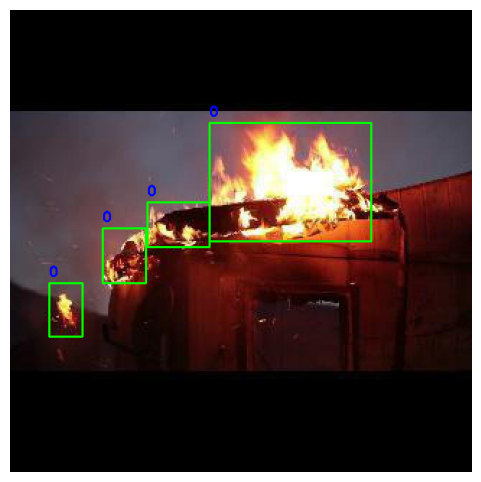


Processing /kaggle/working/Fire-Detection-1/valid - Found 925 images, sampling 925
Saved sampled dataset to /kaggle/working/Fire-Detection-1/valid_sampled
Displaying 5 samples:


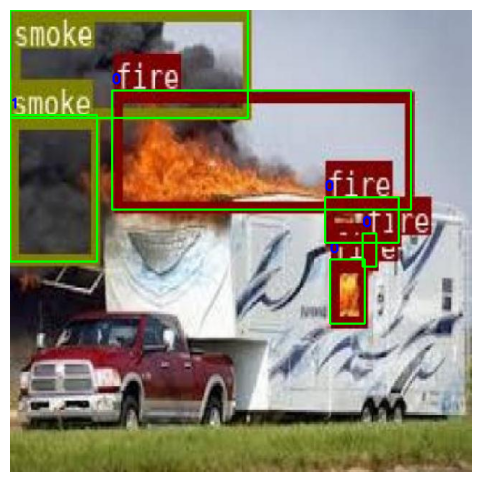

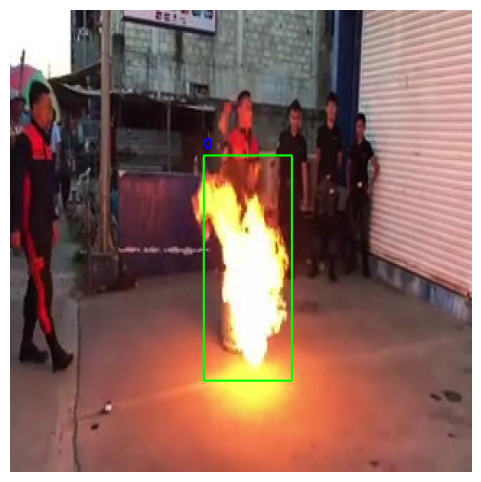

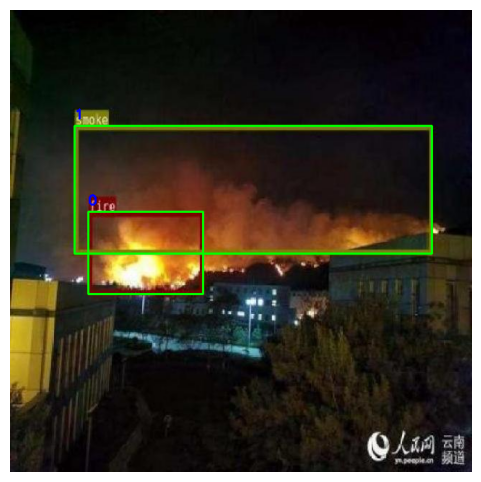

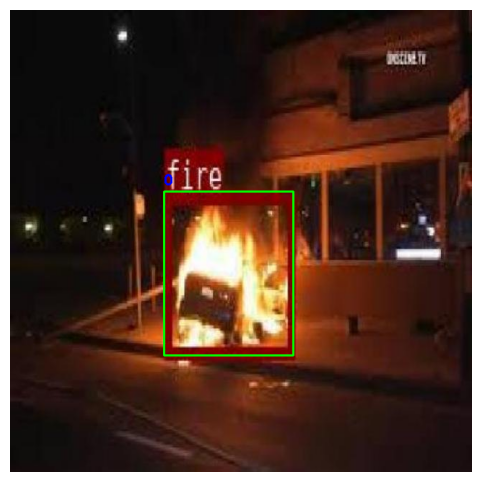

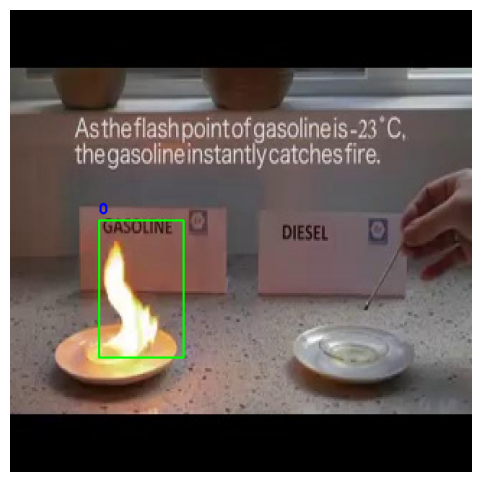


Processing /kaggle/working/Fire-Detection-1/test - Found 960 images, sampling 960
Saved sampled dataset to /kaggle/working/Fire-Detection-1/test_sampled
Displaying 5 samples:


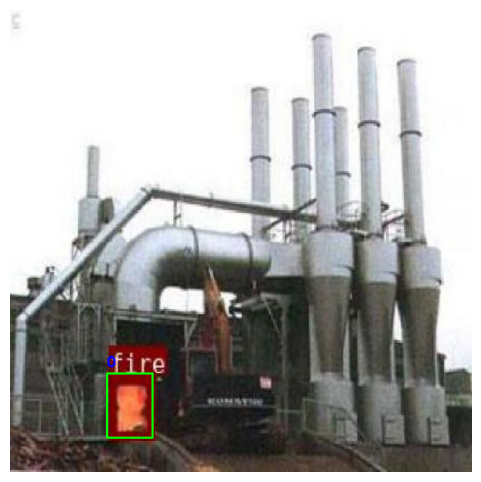

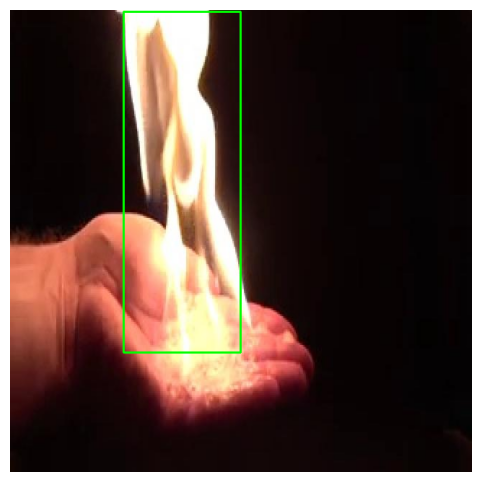

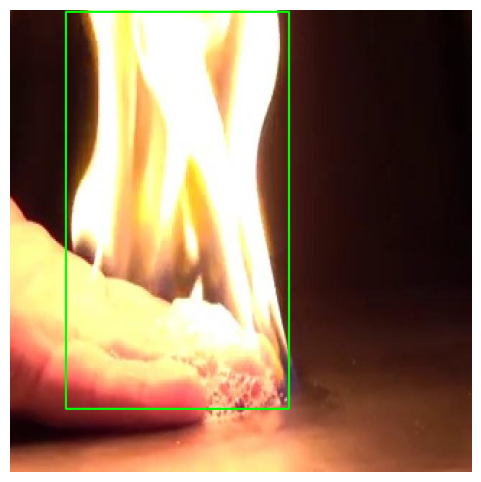

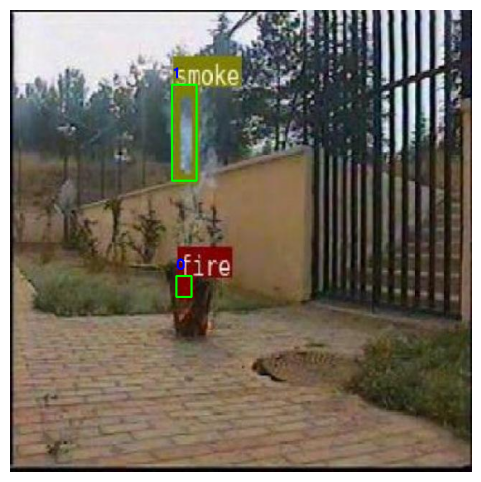

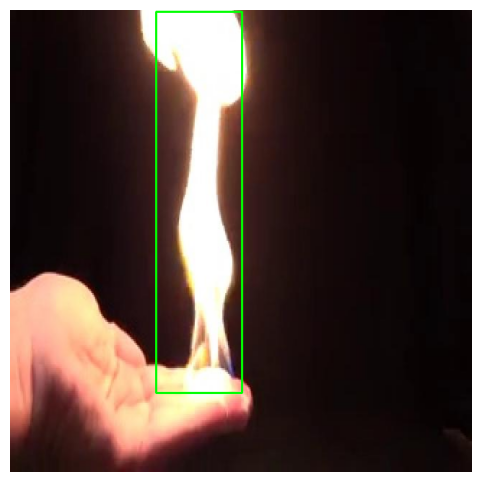

In [95]:
def display_yolo_image(img_path, lbl_path):
    """Display image with YOLO annotations"""
    img = cv2.imread(img_path)
    if img is None:
        print(f"Could not read image: {img_path}")
        return
        
    h, w = img.shape[:2]

    if not os.path.exists(lbl_path):
        print(f"No label file found: {lbl_path}")
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
        return

    with open(lbl_path, "r") as f:
        for line in f:
            try:
                class_id, x_center, y_center, bw, bh = map(float, line.strip().split())
                x1 = int((x_center - bw/2) * w)
                y1 = int((y_center - bh/2) * h)
                x2 = int((x_center + bw/2) * w)
                y2 = int((y_center + bh/2) * h)
                cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(img, str(int(class_id)), (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
            except ValueError:
                print(f"Error parsing line in {lbl_path}: {line.strip()}")

    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def sample_and_display_dataset(base_dir, sample_ratio=0.5, display_samples=5, save_copy=False):
    """Process a dataset directory (train/test/valid)"""
    img_dir = os.path.join(base_dir, "images")
    lbl_dir = os.path.join(base_dir, "labels")
    
    if not os.path.exists(img_dir) or not os.path.exists(lbl_dir):
        print(f"Skipping {base_dir} - missing images or labels folder")
        return
    
    image_paths = sorted(glob(os.path.join(img_dir, "*.jpg")))
    if not image_paths:
        print(f"No images found in {img_dir}")
        return
        
    sample_size = int(len(image_paths) * sample_ratio)
    sampled_images = random.sample(image_paths, sample_size)
    
    print(f"\nProcessing {base_dir} - Found {len(image_paths)} images, sampling {sample_size}")
    
    if save_copy:
        new_dir = base_dir + "_sampled"
        new_img_dir = os.path.join(new_dir, "images")
        new_lbl_dir = os.path.join(new_dir, "labels")
        os.makedirs(new_img_dir, exist_ok=True)
        os.makedirs(new_lbl_dir, exist_ok=True)
        
        for img_path in sampled_images:
            lbl_path = os.path.join(lbl_dir, os.path.basename(img_path).replace(".jpg", ".txt"))
            shutil.copy(img_path, new_img_dir)
            if os.path.exists(lbl_path):
                shutil.copy(lbl_path, new_lbl_dir)
        print(f"Saved sampled dataset to {new_dir}")
    
    print(f"Displaying {min(display_samples, len(sampled_images))} samples:")
    for img_path in sampled_images[:display_samples]:
        lbl_path = os.path.join(lbl_dir, os.path.basename(img_path).replace(".jpg", ".txt"))
        display_yolo_image(img_path, lbl_path)

base_path = "/kaggle/working/Fire-Detection-1"
datasets = ["train", "valid", "test"]

for dataset in datasets:
    dataset_path = os.path.join(base_path, dataset)
    sample_and_display_dataset(dataset_path, sample_ratio=1, display_samples=5, save_copy=True)

In [96]:
yaml_path = "/kaggle/working/Fire-Detection-1/data.yaml"

try:
    with open(yaml_path, 'r') as file:
        data = yaml.safe_load(file)
    
    print("Class mappings:")
    for i, name in enumerate(data['names']):
        print(f"{i}: {name}")
    
    print("\nFull dataset config:")
    print(data)
except FileNotFoundError:
    print(f"Error: {yaml_path} not found!")
except Exception as e:
    print(f"Error reading YAML file: {e}")

Class mappings:
0: Fire
1: Smoke

Full dataset config:
{'names': ['Fire', 'Smoke'], 'nc': 2, 'roboflow': {'license': 'CC BY 4.0', 'project': 'fire-detection-ypseh', 'url': 'https://universe.roboflow.com/situational-awarnessinnovsense/fire-detection-ypseh/dataset/1', 'version': 1, 'workspace': 'situational-awarnessinnovsense'}, 'test': '../test/images', 'train': 'Fire-Detection-1/train/images', 'val': 'Fire-Detection-1/valid/images'}


In [97]:
!pip install ultralytics pyyaml

### Creating Subsets

In [98]:

def create_subset(original_dir, subset_dir, sample_size=100):
    if os.path.exists(subset_dir):
        shutil.rmtree(subset_dir)

    os.makedirs(os.path.join(subset_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(subset_dir, 'labels'), exist_ok=True)

    img_files = glob(os.path.join(original_dir, 'images', '*.jpg'))
    annotated_imgs = [
        img for img in img_files
        if os.path.exists(img.replace('images', 'labels').replace('.jpg', '.txt'))
    ]

    sampled = random.sample(annotated_imgs, min(sample_size, len(annotated_imgs)))

    for img_path in sampled:
        shutil.copy(img_path, os.path.join(subset_dir, 'images'))
        label_path = img_path.replace('images', 'labels').replace('.jpg', '.txt')
        shutil.copy(label_path, os.path.join(subset_dir, 'labels'))

base_path = "/kaggle/working/Fire-Detection-1"

create_subset(os.path.join(base_path, 'train'), os.path.join(base_path, 'train_small'), 7000)
create_subset(os.path.join(base_path, 'valid'), os.path.join(base_path, 'valid_small'), 700)
create_subset(os.path.join(base_path, 'test'), os.path.join(base_path, 'test_small'), 700)

def print_dataset_sizes(base_path):
    dirs = ['train', 'train_small', 'valid', 'valid_small']
    for d in dirs:
        img_dir = os.path.join(base_path, d, 'images')
        lbl_dir = os.path.join(base_path, d, 'labels')

        num_imgs = len([f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
        num_lbls = len(glob(os.path.join(lbl_dir, '*.txt')))

        print(f"\nContents of '{os.path.join(base_path, d)}':")
        print(f"  Images: {num_imgs}")
        print(f"  Labels: {num_lbls}")

        if 'small' in d:
            expected = 550 if 'train' in d else 55
            if num_imgs != expected or num_lbls != expected:
                print(f"  ❌ Error: Expected {expected}, but got {num_imgs} images and {num_lbls} labels.")
            else:
                print("  ✅ Subset size correct.")

print_dataset_sizes(base_path)


Contents of '/kaggle/working/Fire-Detection-1/train':
  Images: 7673
  Labels: 7673

Contents of '/kaggle/working/Fire-Detection-1/train_small':
  Images: 7000
  Labels: 7000
  ❌ Error: Expected 550, but got 7000 images and 7000 labels.

Contents of '/kaggle/working/Fire-Detection-1/valid':
  Images: 925
  Labels: 925

Contents of '/kaggle/working/Fire-Detection-1/valid_small':
  Images: 700
  Labels: 700
  ❌ Error: Expected 55, but got 700 images and 700 labels.


In [99]:
yaml_path = os.path.join(base_path, 'data.yaml')
with open(yaml_path) as f:
    data = yaml.safe_load(f)

data['train'] = os.path.join(base_path, 'train_small')
data['val'] = os.path.join(base_path, 'valid_small')
data['test'] = os.path.join(base_path, 'test_small')

with open(os.path.join(base_path, 'data_small.yaml'), 'w') as f:
    yaml.dump(data, f)

### Data Augmentation

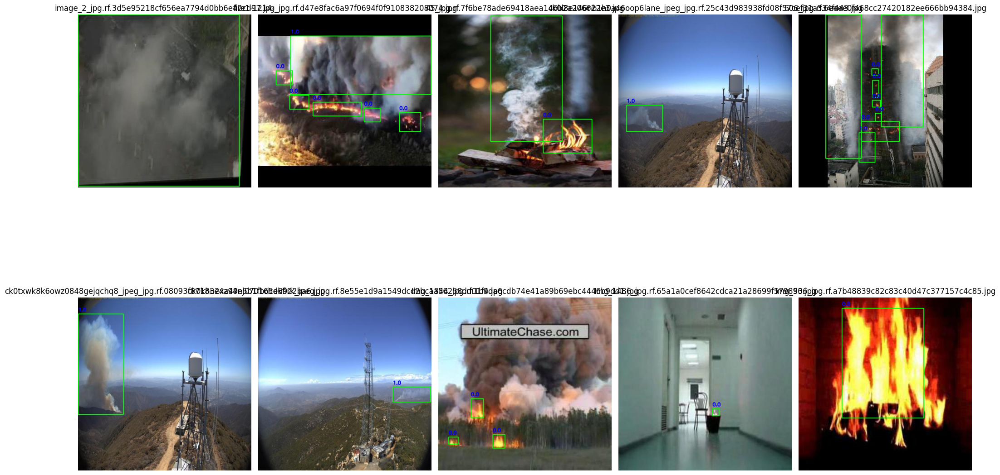

In [100]:


def get_transform(resize_dim=None):
    transforms = [
    ]
    
    if resize_dim is not None:
        transforms.append(A.Resize(height=resize_dim, width=resize_dim))

    return A.Compose(
        transforms,
        bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels'])
    )

def draw_bboxes(image, bboxes, class_labels):
    """Draw bounding boxes on image"""
    h, w = image.shape[:2]
    for (xc, yc, bw, bh), cls in zip(bboxes, class_labels):
        x1 = int((xc - bw/2) * w)
        y1 = int((yc - bh/2) * h)
        x2 = int((xc + bw/2) * w)
        y2 = int((yc + bh/2) * h)
        
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(image, str(cls), (x1, y1 - 10), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
    return image

def augment_and_save(img_path, out_img_dir, out_lbl_dir, transform, sample_images=None):
    lbl_path = img_path.replace('/images/', '/labels/').replace('.jpg', '.txt')
    
    image = cv2.imread(img_path)
    h, w = image.shape[:2]

    class_labels, bboxes = [], []
    with open(lbl_path) as f:
        for line in f:
            cls, xc, yc, bw, bh = map(float, line.split())
            class_labels.append(int(cls))
            bboxes.append([xc, yc, bw, bh])

    augmented = transform(image=image, bboxes=bboxes, class_labels=class_labels)
    aug_img = augmented['image']
    aug_bboxes = augmented['bboxes']
    aug_classes = augmented['class_labels']

    basename = os.path.basename(img_path)
    aug_path = os.path.join(out_img_dir, basename)
    cv2.imwrite(aug_path, aug_img)

    if sample_images is not None and len(sample_images) < 10:
        img_with_boxes = draw_bboxes(aug_img.copy(), aug_bboxes, aug_classes)
        sample_images.append((img_with_boxes, basename))

    out_lbl = os.path.join(out_lbl_dir, basename.replace('.jpg', '.txt'))
    with open(out_lbl, 'w') as f:
        for cls, (xc, yc, bw, bh) in zip(aug_classes, aug_bboxes):
            f.write(f"{cls} {xc:.6f} {yc:.6f} {bw:.6f} {bh:.6f}\n")

train_img_dir = "/kaggle/working/Fire-Detection-1/train_small/images"
out_img_dir = "/kaggle/working/Fire-Detection-1/train_aug/images"
out_lbl_dir = "/kaggle/working/Fire-Detection-1/train_aug/labels"

os.makedirs(out_img_dir, exist_ok=True)
os.makedirs(out_lbl_dir, exist_ok=True)

sample_images = []

resize_dim = 640
transform = get_transform(resize_dim)

img_paths = glob(os.path.join(train_img_dir, "*.jpg"))
for img_path in img_paths:
    augment_and_save(img_path, out_img_dir, out_lbl_dir, transform, sample_images)

plt.figure(figsize=(20, 15))
for i, (img, title) in enumerate(sample_images[:10], 1):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(2, 5, i)
    plt.imshow(img_rgb)
    plt.title(title)
    plt.axis('off')
plt.tight_layout()
plt.show()

### Yolo Training

In [101]:
model = YOLO('yolov8s.pt')  

results = model.train(
    data=os.path.join(base_path, 'data_small.yaml'),
    epochs=35,
    imgsz=640,
    batch=16,
    name='fire_detection_small',
    exist_ok = True
)

Ultralytics 8.3.112 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/kaggle/working/Fire-Detection-1/data_small.yaml, epochs=35, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=fire_detection_small, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_con

### Testing YOLO model

In [102]:
best_model = YOLO(os.path.join('runs', 'detect', 'fire_detection_small', 'weights', 'best.pt'))

metrics = best_model.val(
    data=os.path.join(base_path, 'data_small.yaml'),
    split='test'  
)

print(metrics.box.map)  

Ultralytics 8.3.112 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 924.8±346.3 MB/s, size: 41.9 KB)
val: Scanning /kaggle/working/Fire-Detection-1/test/labels.cache... 960 images, 2 backgrounds, 0 corrupt: 100%|██████████| 960/960 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 12, len(boxes) = 2146. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 60/60 [00:13<00:00,  4.55it/s]
                   all        960       2146      0.932      0.861      0.893      0.775
                  Fire        930       1483       0.92      0.893       0.93      0.737
                

We got very high values for all metrics. Since this is a general fire it was mostly expected.


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_020_jpg.rf.a272ca90ce37a73bfd657f7a43fb72a0.jpg: 640x640 1 Fire, 16.3ms
Speed: 2.9ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


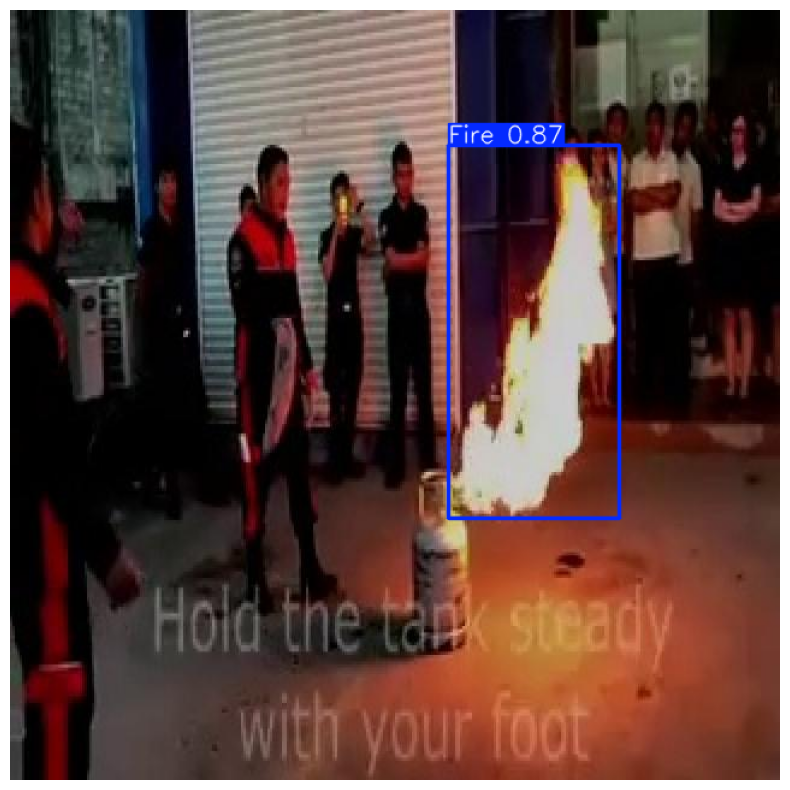


image 1/1 /kaggle/working/Fire-Detection-1/test/images/large_-401-_jpg.rf.5a8971e9fa6974a64aaeb7bf3ade00b2.jpg: 640x640 1 Fire, 1 Smoke, 16.4ms
Speed: 3.5ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


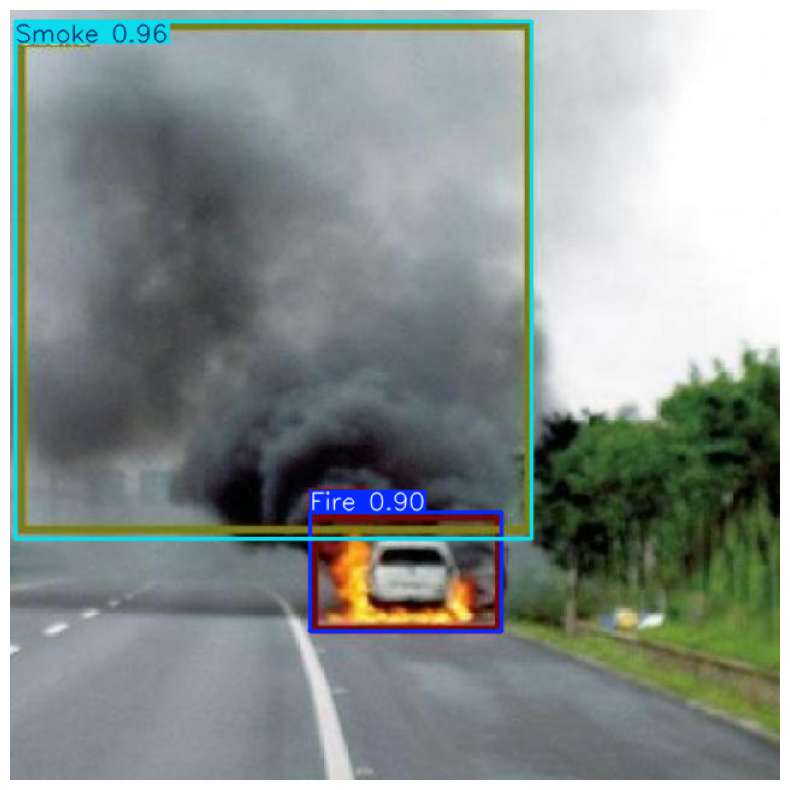


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_49_jpg.rf.ab3c1452eb84574d1bfbf58f82226b17.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.6ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


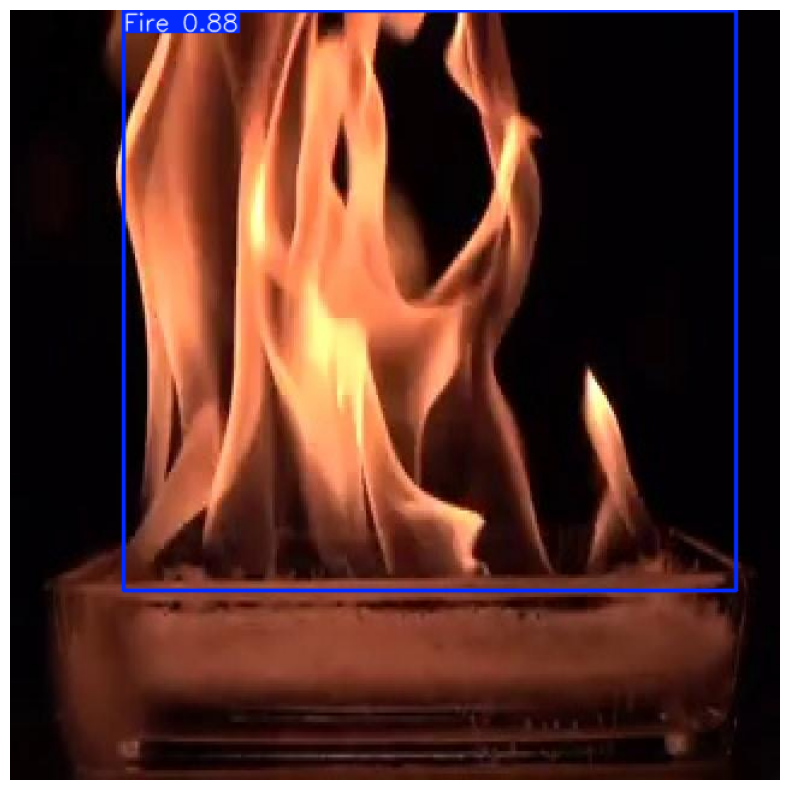


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2496-_jpg.rf.88d812b1e8c4604aba92aa5f40f59cfc.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.9ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


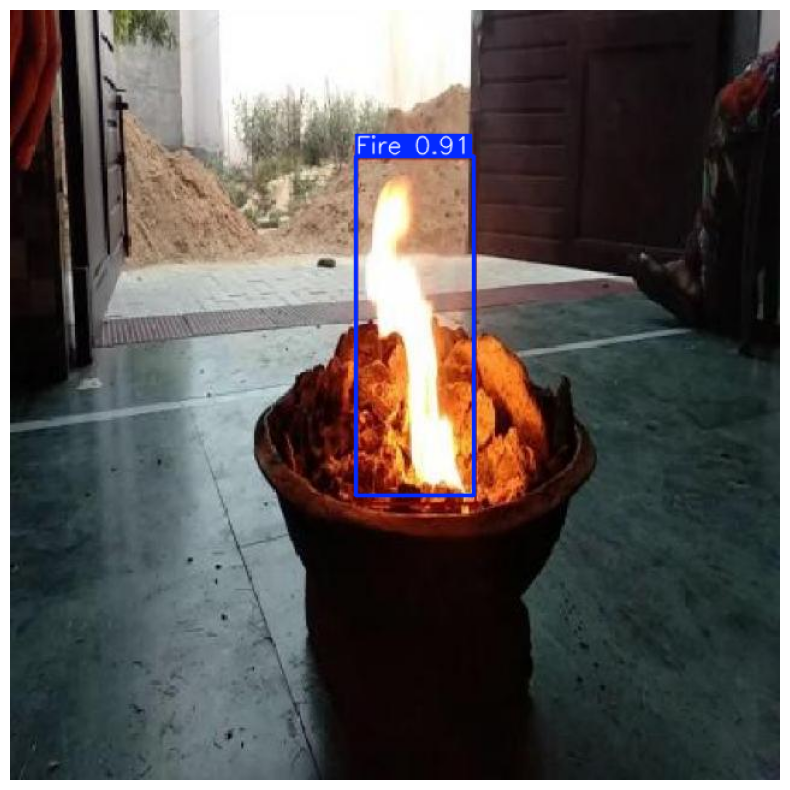


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-4019-_jpg.rf.0c04896951e5f5e2ad88fb315d5b2585.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.0ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


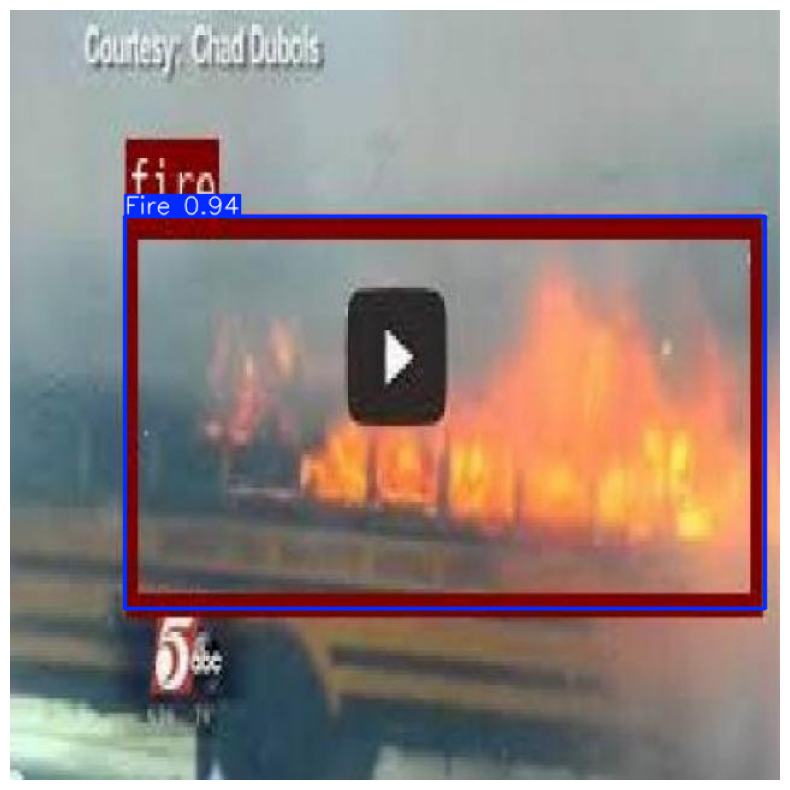


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_108_jpg.rf.1b0eeaff916b40663c5536bfb5a002a0.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.1ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


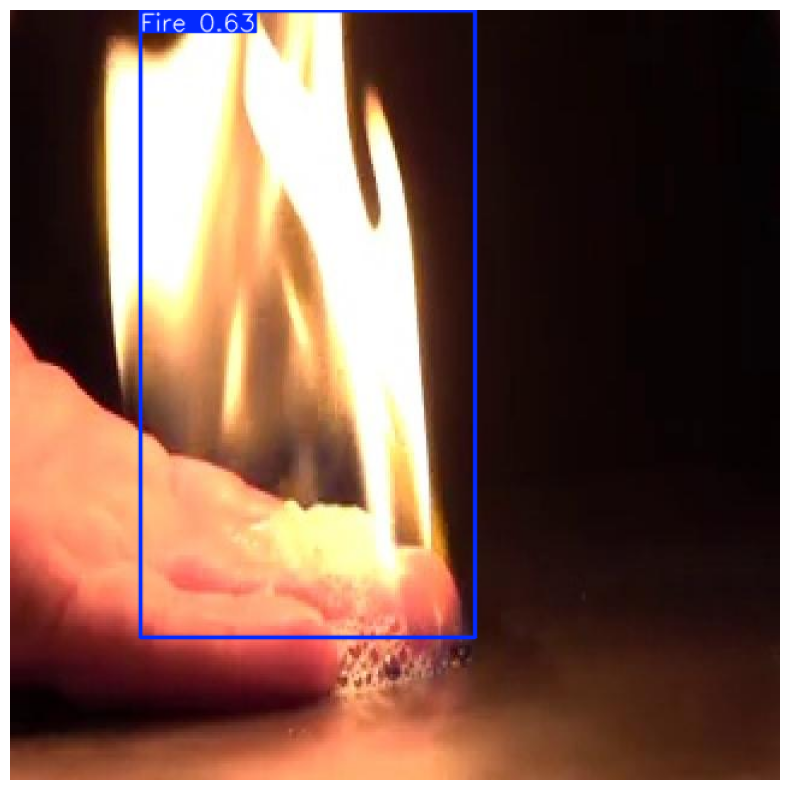


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_24_jpg.rf.aada5903ca5d8a6d3aa99dd9eb91dbc6.jpg: 640x640 1 Fire, 16.4ms
Speed: 1.9ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


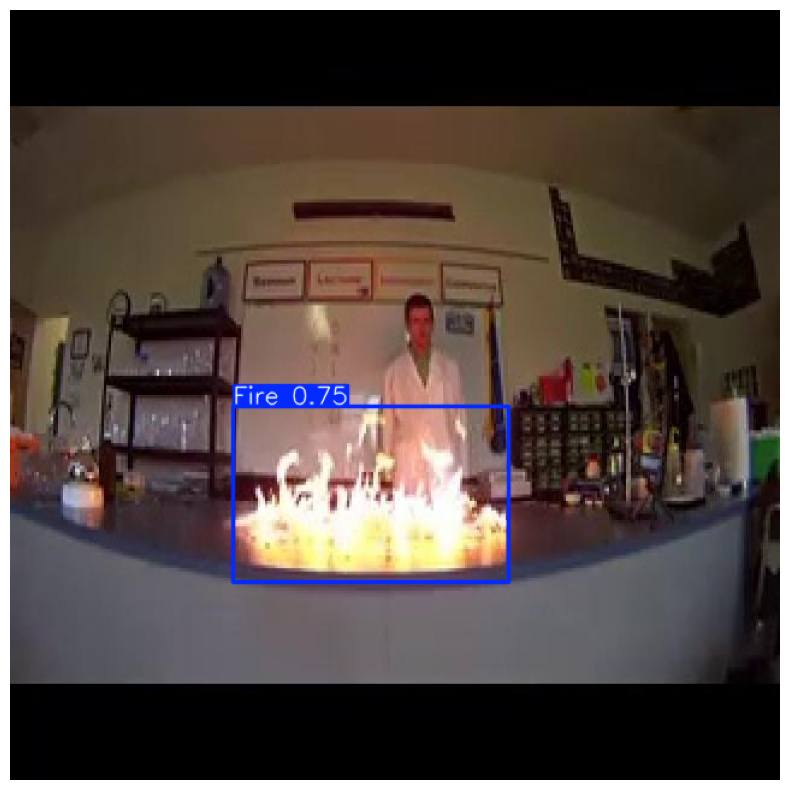


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_100_jpg.rf.50c118983ba146bab2473dff2612c5f5.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.2ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


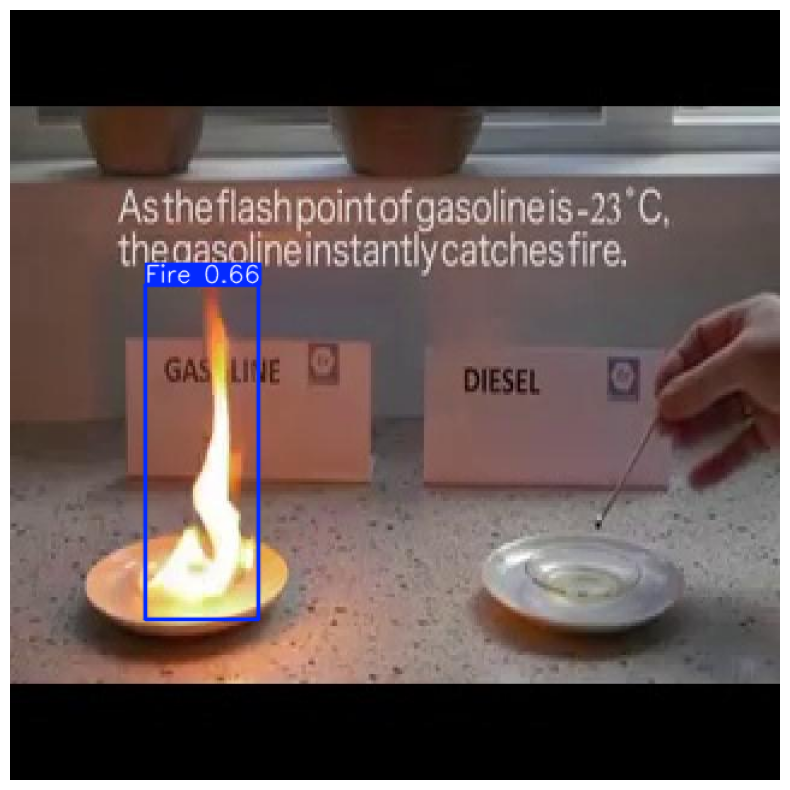


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-3933-_jpg.rf.cf6e607e24e662422cc5737edce7b748.jpg: 640x640 3 Smokes, 16.4ms
Speed: 1.7ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


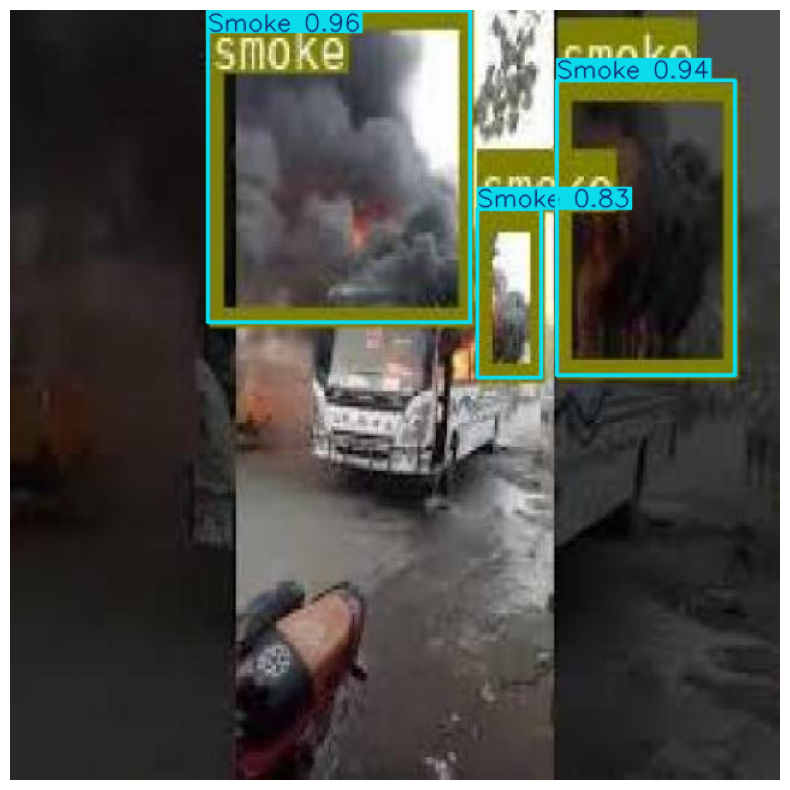


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_180_jpg.rf.9a0ba1805d530e867840611e842249bc.jpg: 640x640 (no detections), 16.4ms
Speed: 2.1ms preprocess, 16.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


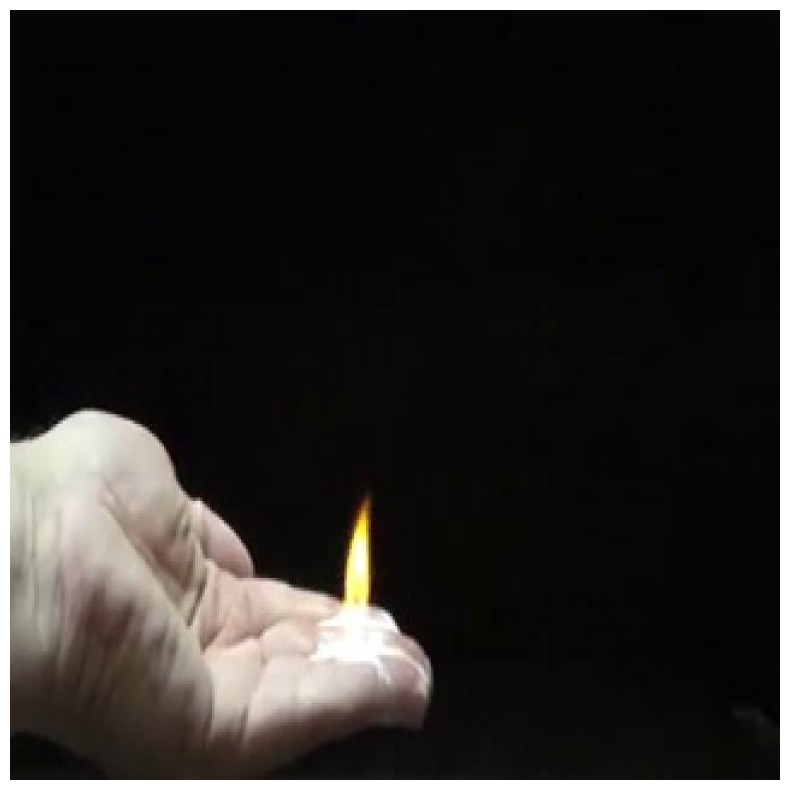


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2260-_jpg.rf.90d4d8fbd0ad9aea6963730ff4798168.jpg: 640x640 6 Fires, 16.4ms
Speed: 1.7ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


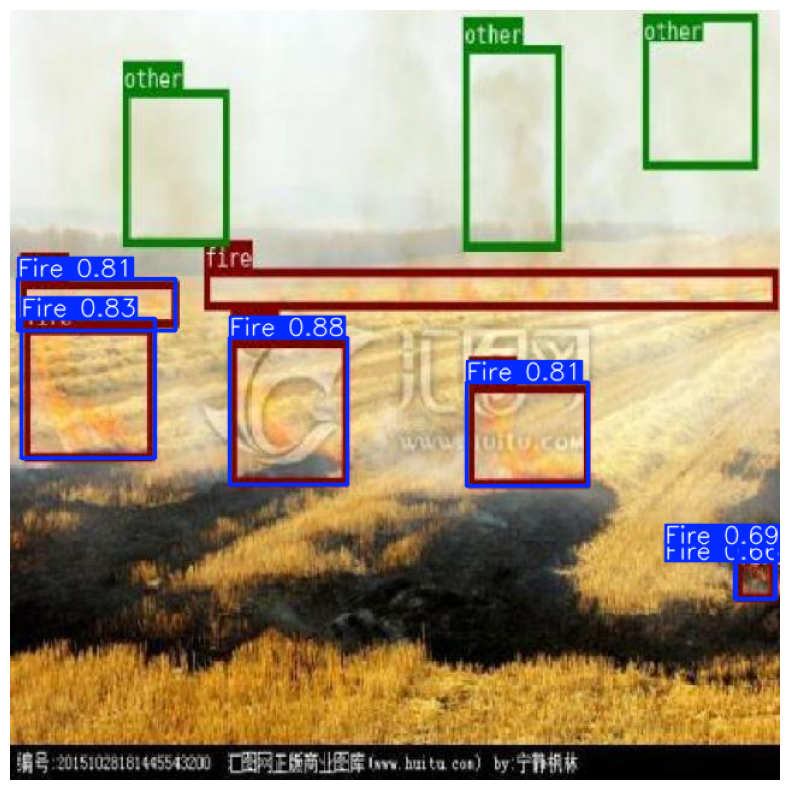


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2110-_jpg.rf.54b8ff3a146fd42c911330d3f52223d4.jpg: 640x640 7 Fires, 16.4ms
Speed: 1.7ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


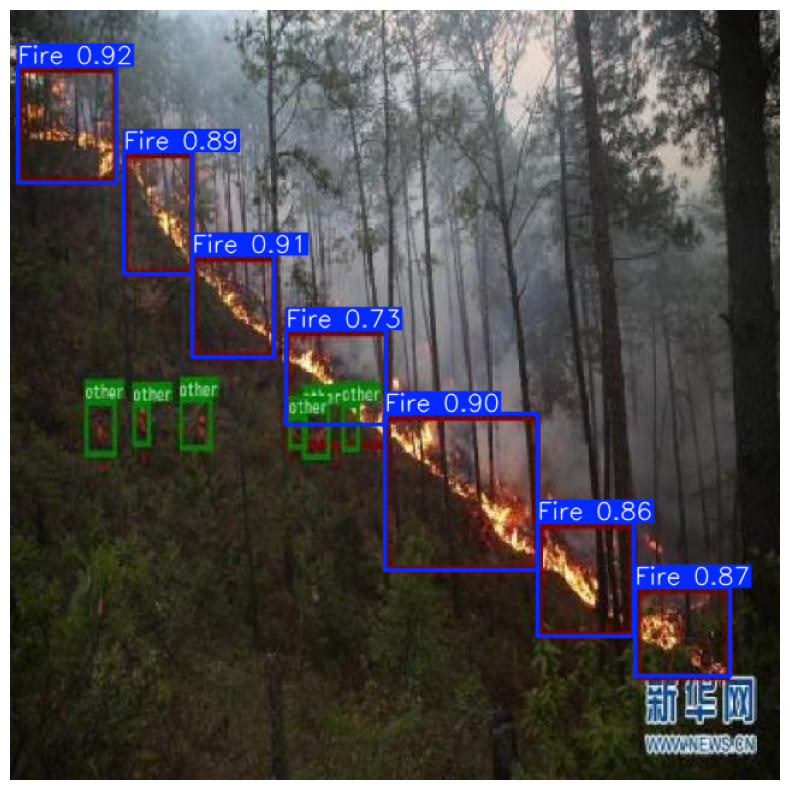


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_093_jpg.rf.545cf856f677ff8a7d7dad738e8da846.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.6ms preprocess, 16.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


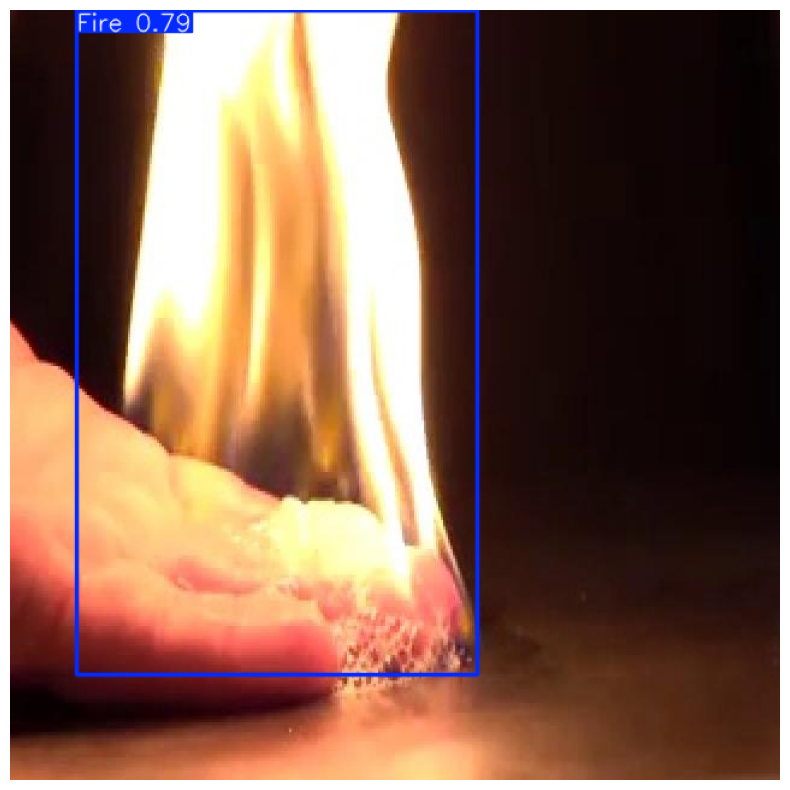


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2401-_jpg.rf.205c8e17b5fa77e5d28cc546e25c1c83.jpg: 640x640 2 Fires, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


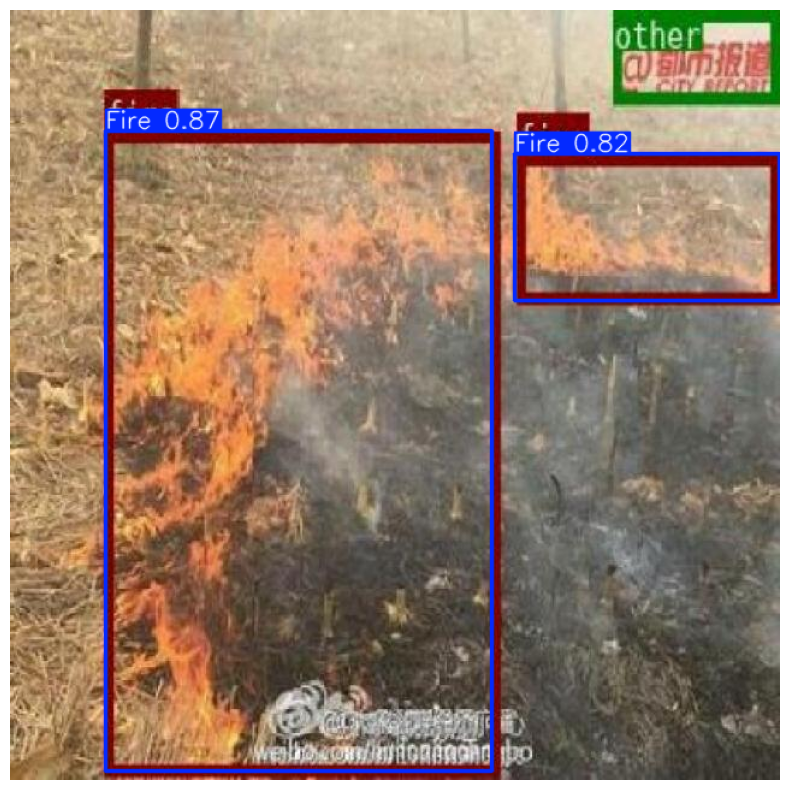


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_5_jpg.rf.7610cc53642f1bc6ffb3bf67adf96c1f.jpg: 640x640 (no detections), 16.4ms
Speed: 1.9ms preprocess, 16.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


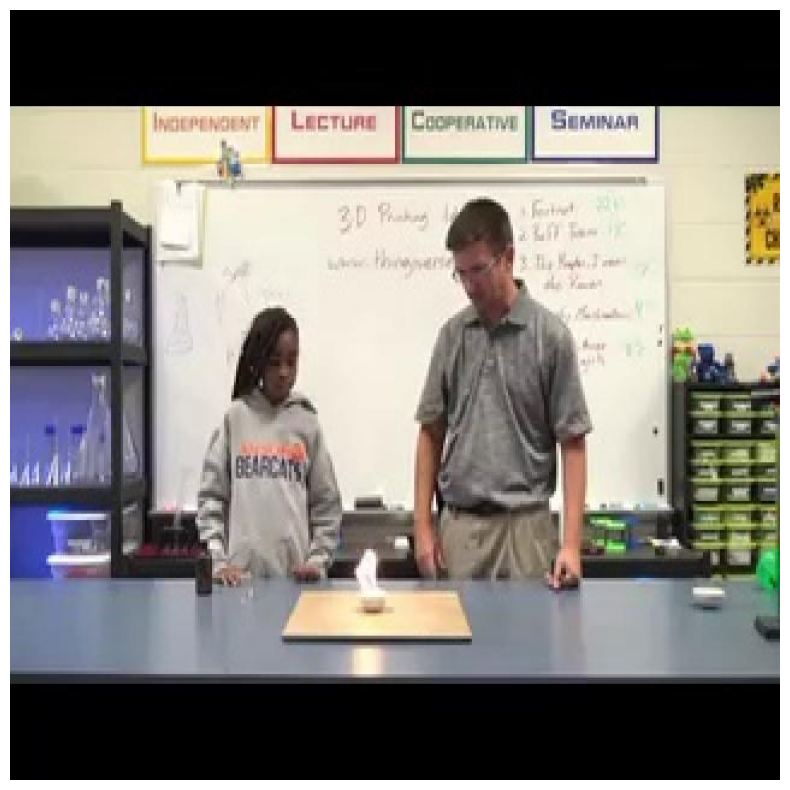


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-1934-_jpg.rf.dda3ea3232265fc02417042d0ddd95cd.jpg: 640x640 2 Fires, 2 Smokes, 16.4ms
Speed: 2.1ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


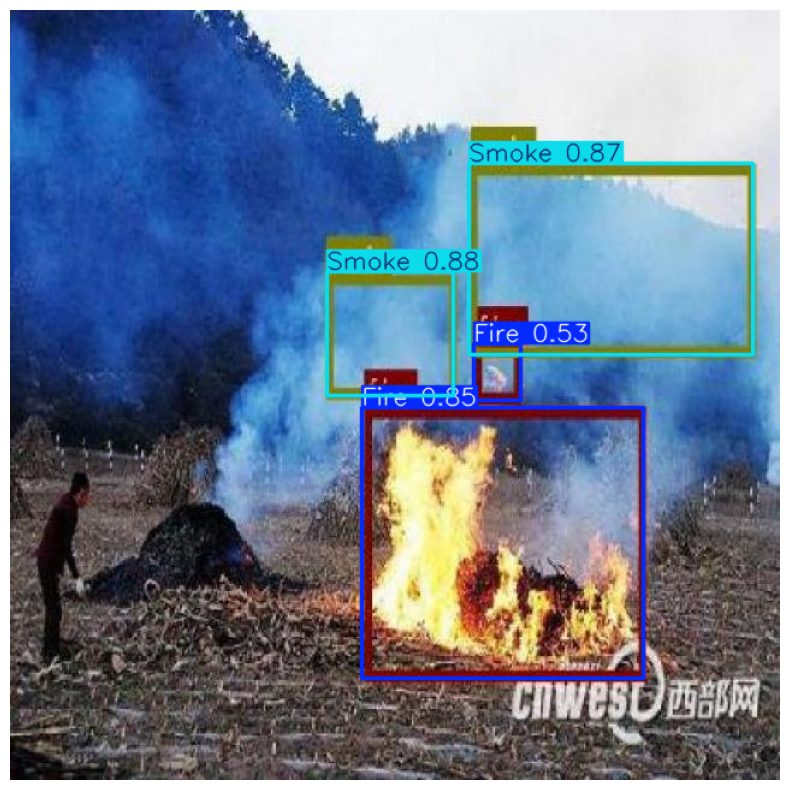


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-3934-_jpg.rf.291b057da33873802ef984f51859a4f4.jpg: 640x640 1 Fire, 1 Smoke, 16.4ms
Speed: 1.8ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


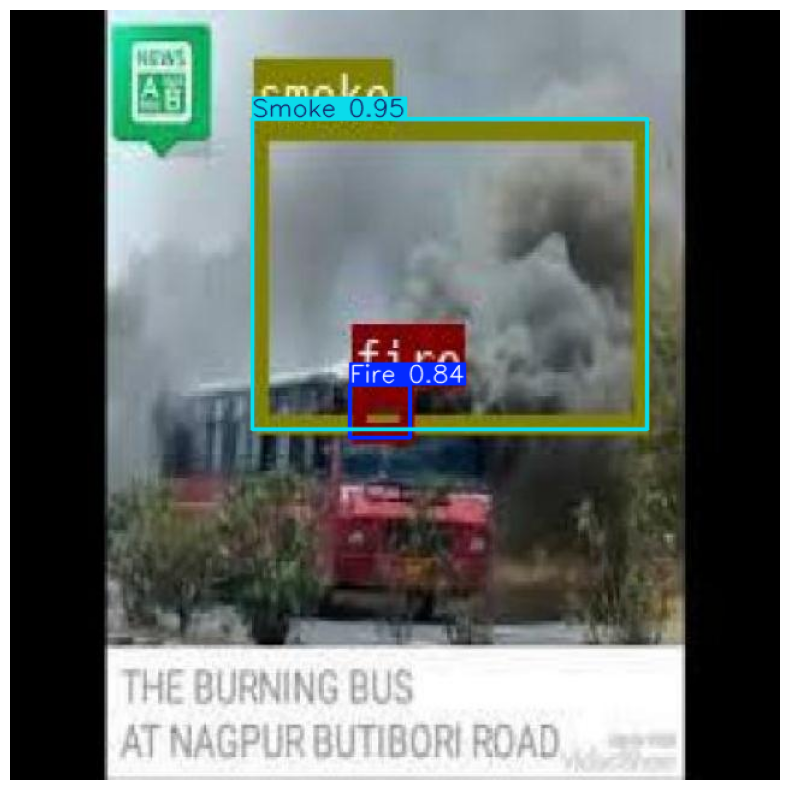


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_113_jpg.rf.4ebb7b9772a9ce179e48ba100db2c098.jpg: 640x640 (no detections), 16.4ms
Speed: 2.1ms preprocess, 16.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


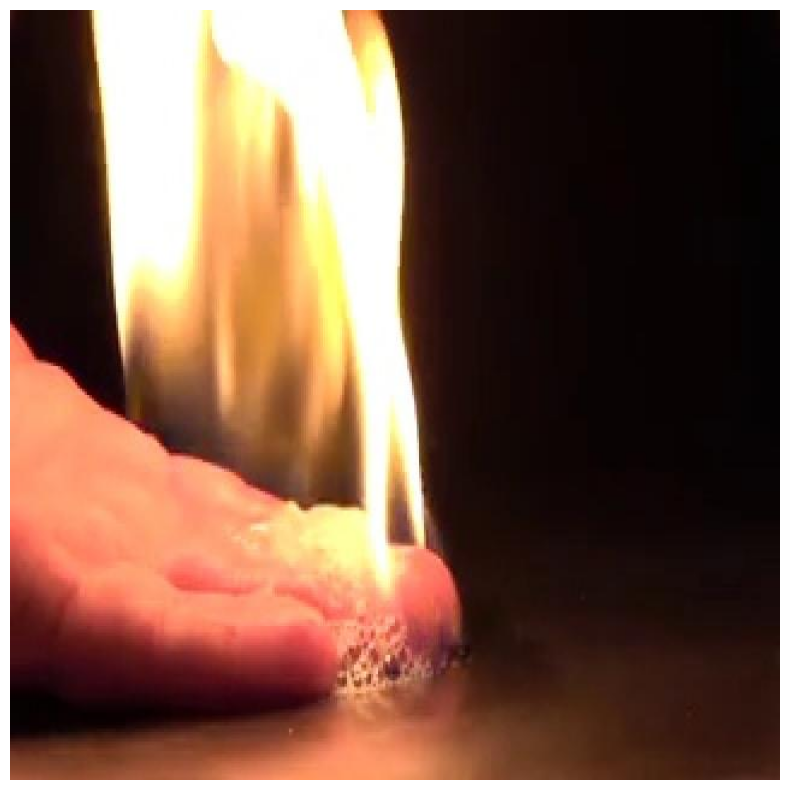


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_011_jpg.rf.a692decc64d225b4cf86408fd6336684.jpg: 640x640 1 Fire, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


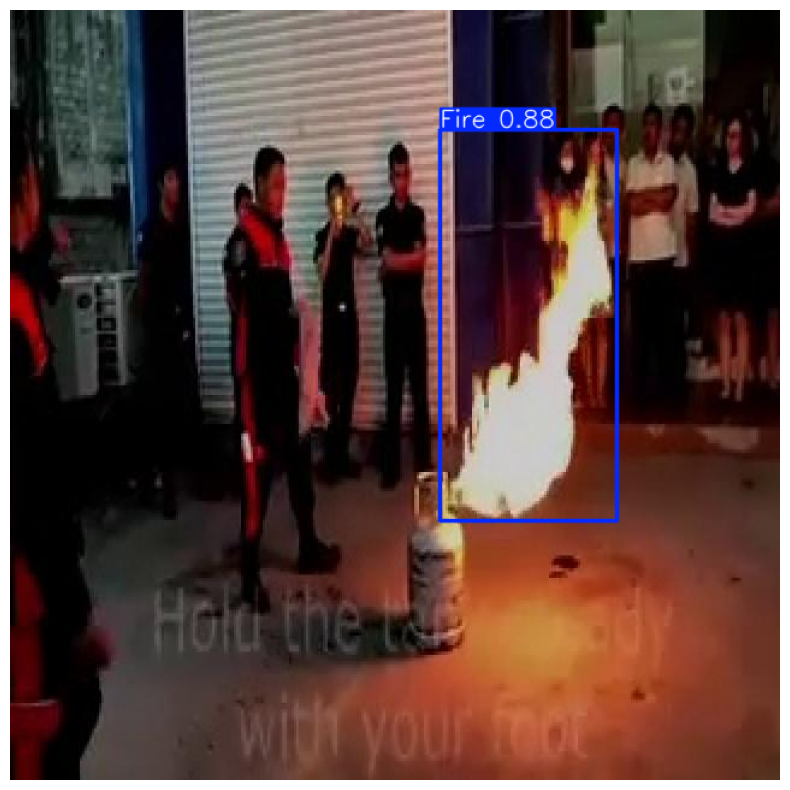


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_204_jpg.rf.0430c7944047c4513318eb4eef99cbdc.jpg: 640x640 1 Fire, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


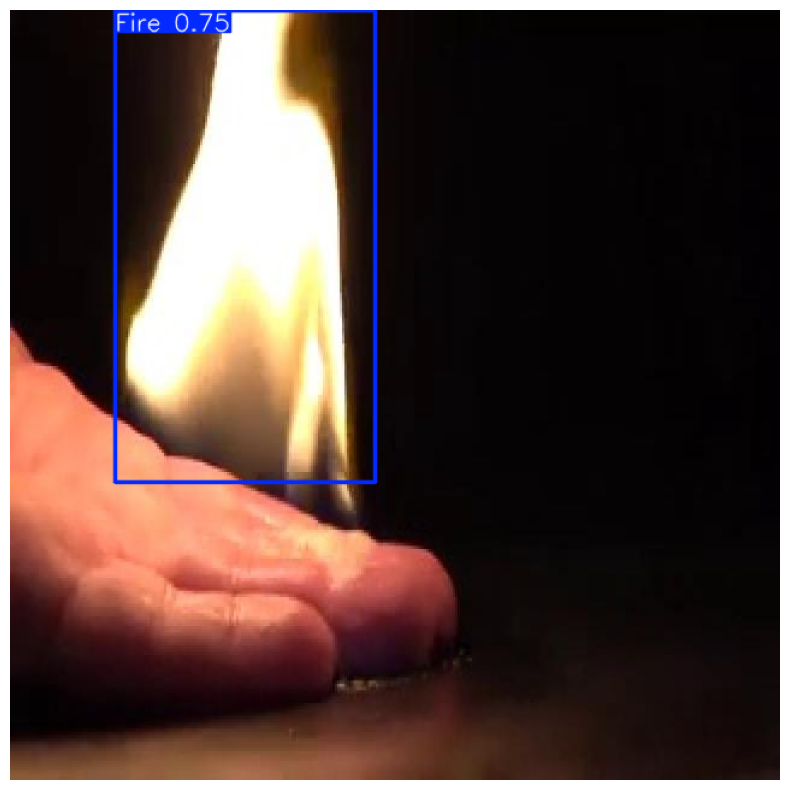

In [103]:
test_images = glob.glob(os.path.join(base_path, 'test', 'images', '*.jpg'))

random_images = random.sample(test_images, min(20, len(test_images)))

for img_path in random_images:
    results = best_model.predict(img_path, conf=0.5)
    res_plotted = results[0].plot() 
    plt.figure(figsize=(10, 10))
    plt.imshow(res_plotted[..., ::-1])  
    plt.axis('off')
    plt.show()

### Loading Clip

In [104]:
model_name = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(model_name)
processor = CLIPProcessor.from_pretrained(model_name)

device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model.to(device)

CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPSdpaAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e

### Analysis of the fire

In [105]:
label_dict = {
    "intensity": ["low intensity", "medium intensity", "high intensity"],
    "control":   ["controlled fire", "Mildily in control" , "uncontrolled fire"],
    "risk":      ["low risk", "medium risk", "high risk"],
}

def classify_crop(crop, labels):
    inputs = processor(text=labels, images=crop,
                       return_tensors="pt", padding=True).to(device)
    clip_model.eval()
    with torch.no_grad():
        logits = clip_model(**inputs).logits_per_image  
    probs = logits.softmax(dim=-1)                
    idx   = probs.argmax(dim=-1).item()
    return labels[idx], probs[0, idx].item()


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_020_jpg.rf.a272ca90ce37a73bfd657f7a43fb72a0.jpg: 640x640 1 Fire, 16.2ms
Speed: 1.5ms preprocess, 16.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


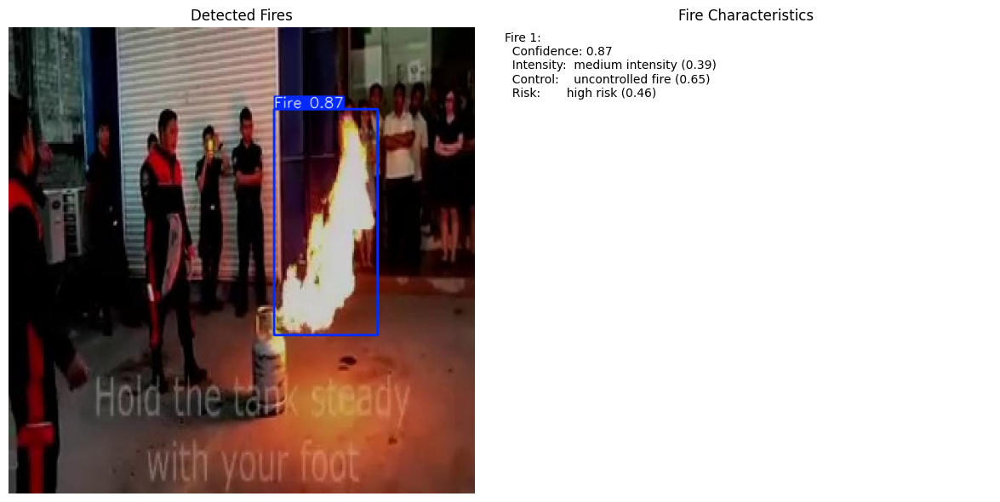


image 1/1 /kaggle/working/Fire-Detection-1/test/images/large_-401-_jpg.rf.5a8971e9fa6974a64aaeb7bf3ade00b2.jpg: 640x640 1 Fire, 1 Smoke, 16.3ms
Speed: 2.1ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


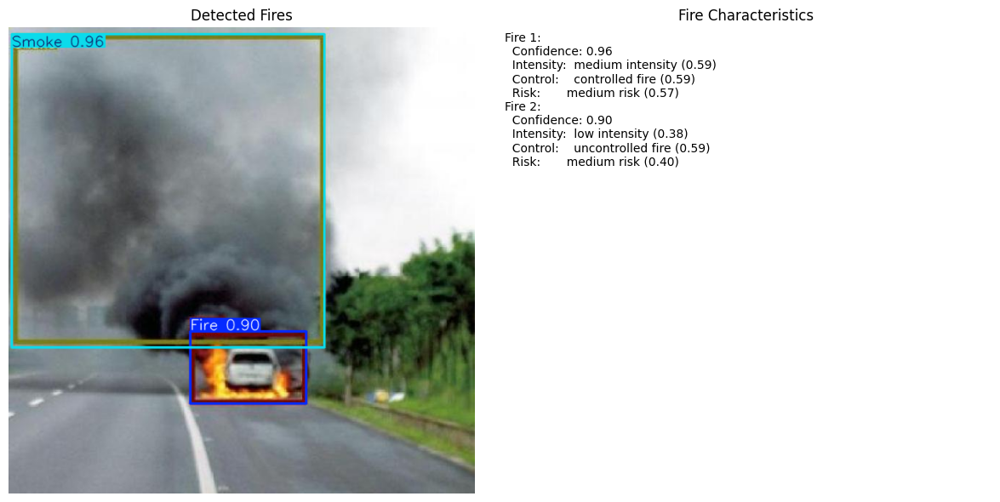


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_49_jpg.rf.ab3c1452eb84574d1bfbf58f82226b17.jpg: 640x640 1 Fire, 16.3ms
Speed: 2.1ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


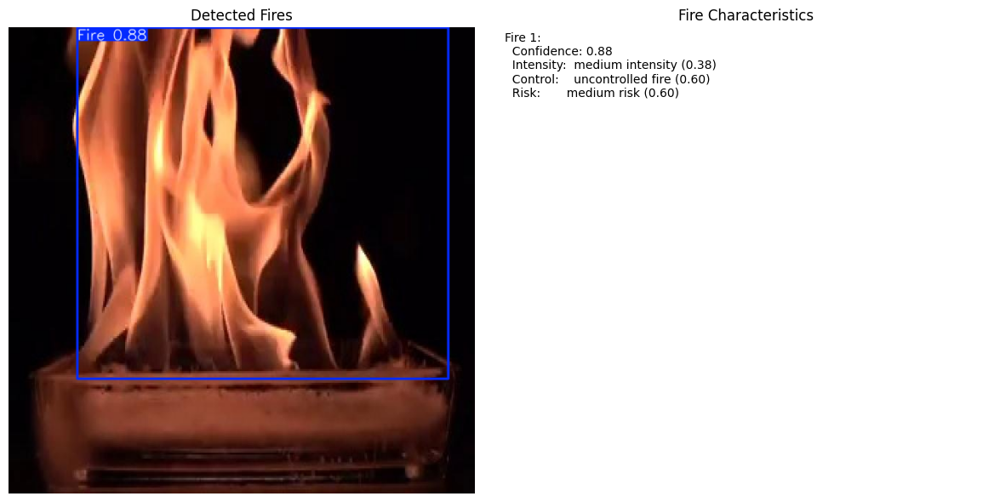


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2496-_jpg.rf.88d812b1e8c4604aba92aa5f40f59cfc.jpg: 640x640 1 Fire, 16.4ms
Speed: 1.9ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


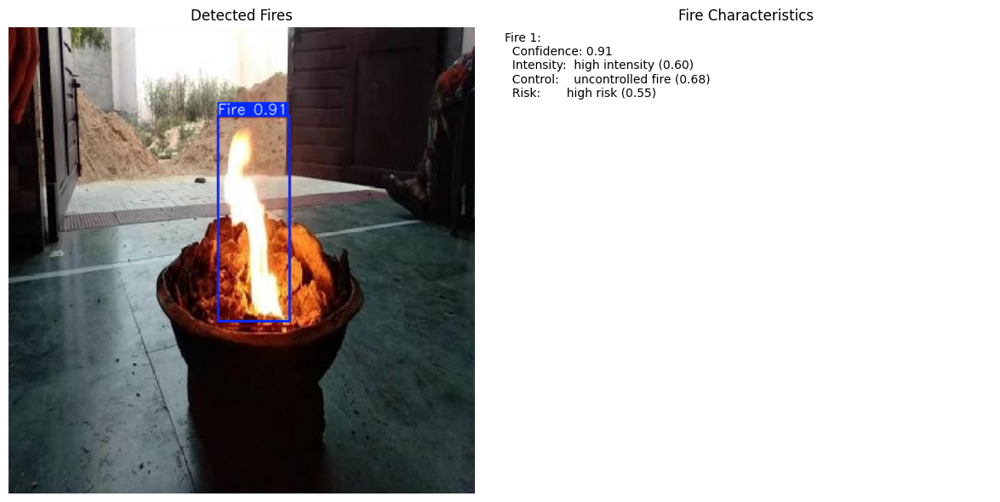


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-4019-_jpg.rf.0c04896951e5f5e2ad88fb315d5b2585.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.6ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


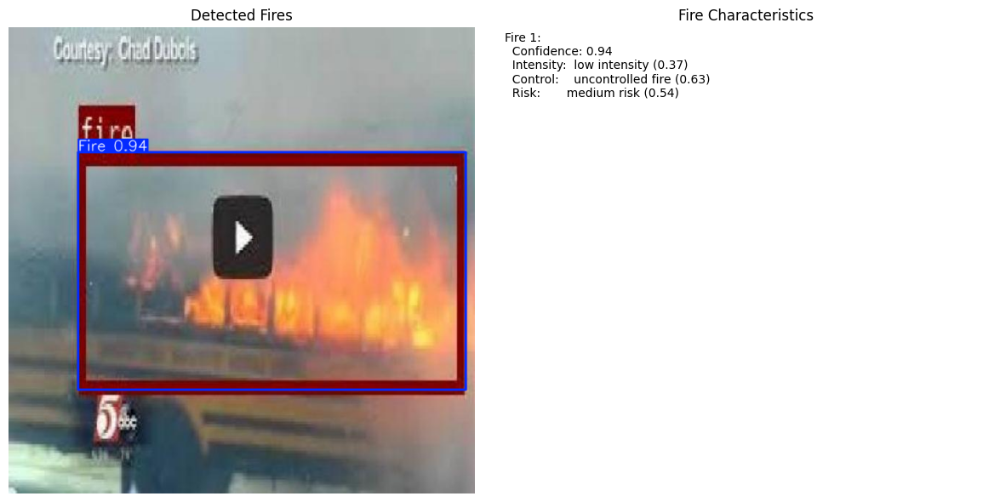


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_108_jpg.rf.1b0eeaff916b40663c5536bfb5a002a0.jpg: 640x640 1 Fire, 16.4ms
Speed: 1.9ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


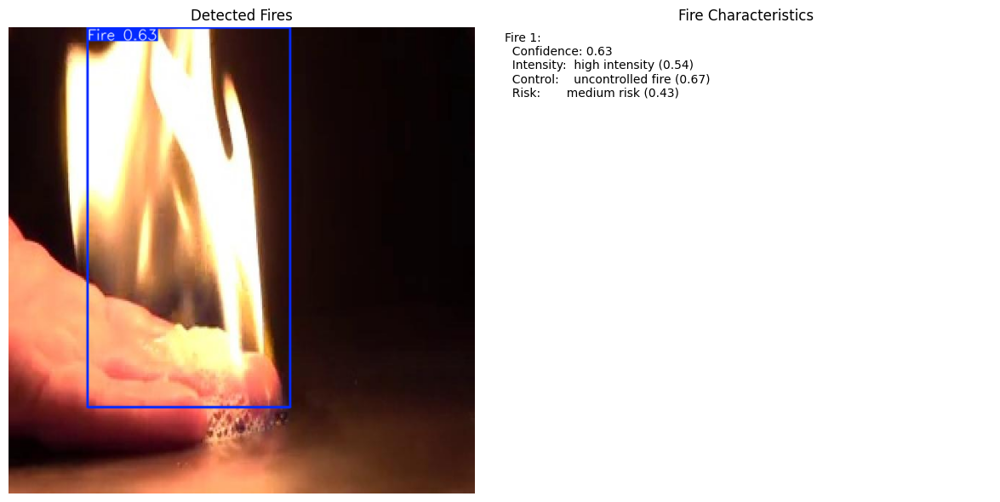


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_24_jpg.rf.aada5903ca5d8a6d3aa99dd9eb91dbc6.jpg: 640x640 1 Fire, 16.3ms
Speed: 1.9ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


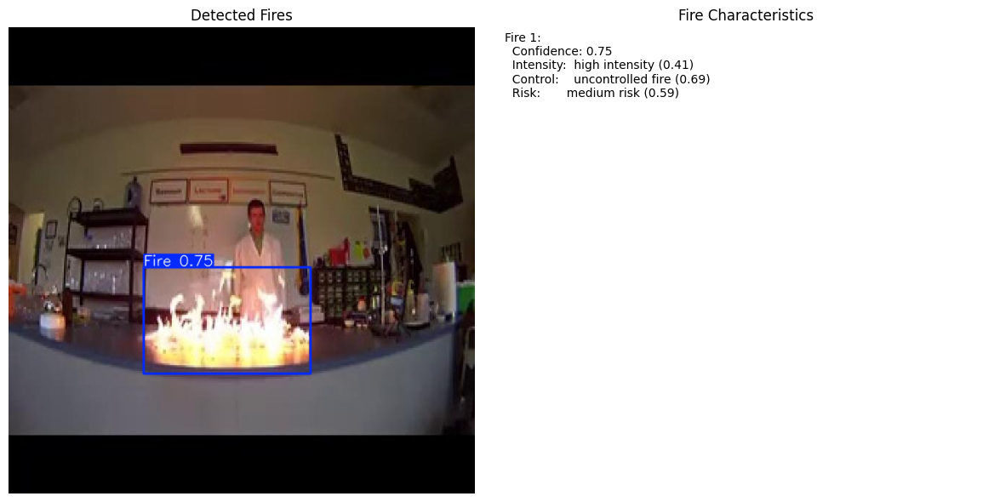


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_100_jpg.rf.50c118983ba146bab2473dff2612c5f5.jpg: 640x640 1 Fire, 16.4ms
Speed: 2.0ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


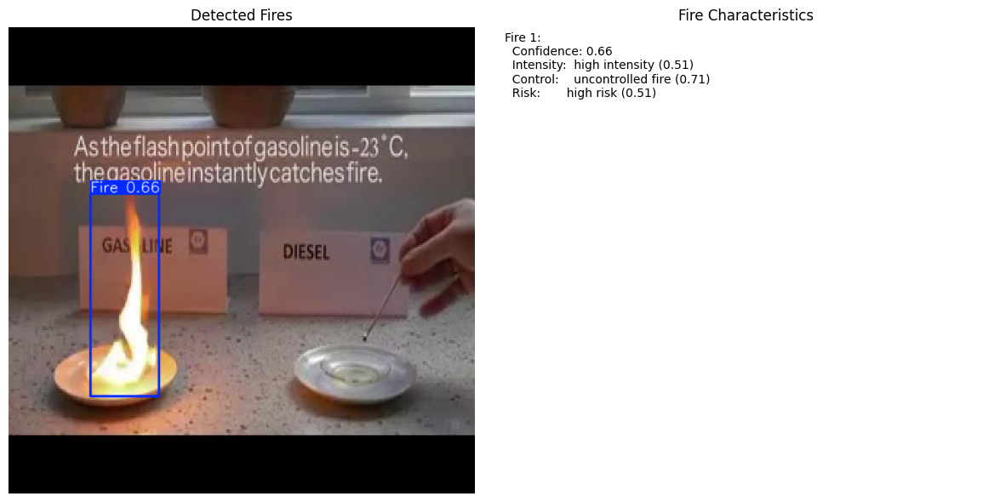


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-3933-_jpg.rf.cf6e607e24e662422cc5737edce7b748.jpg: 640x640 3 Smokes, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


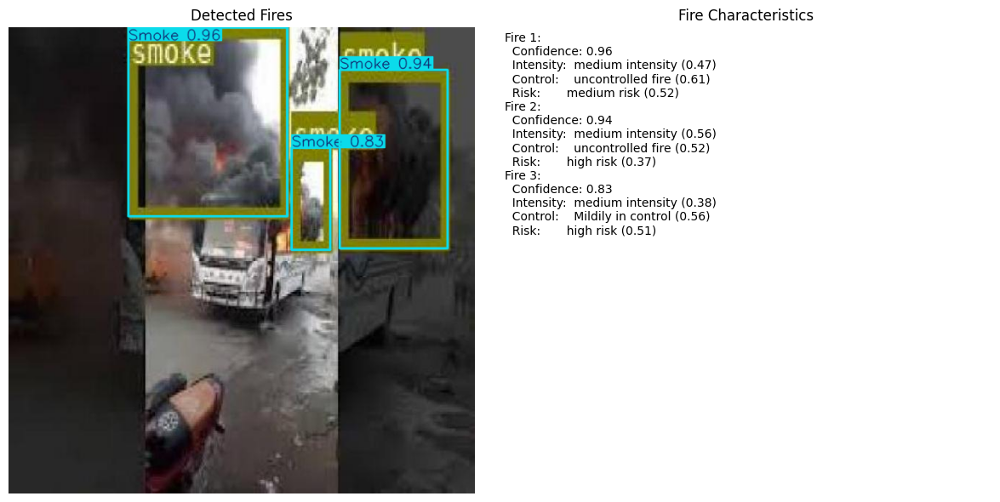


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_180_jpg.rf.9a0ba1805d530e867840611e842249bc.jpg: 640x640 (no detections), 15.7ms
Speed: 2.5ms preprocess, 15.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


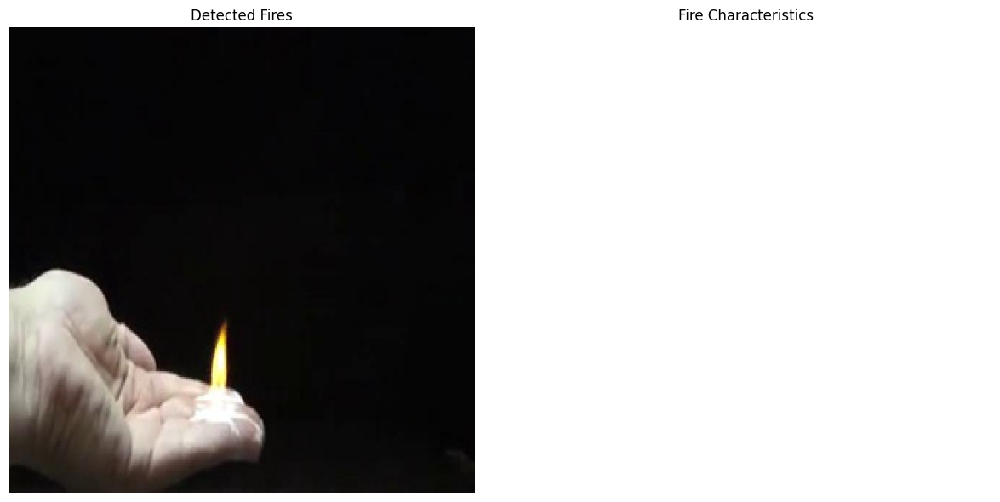


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2260-_jpg.rf.90d4d8fbd0ad9aea6963730ff4798168.jpg: 640x640 6 Fires, 15.6ms
Speed: 1.6ms preprocess, 15.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


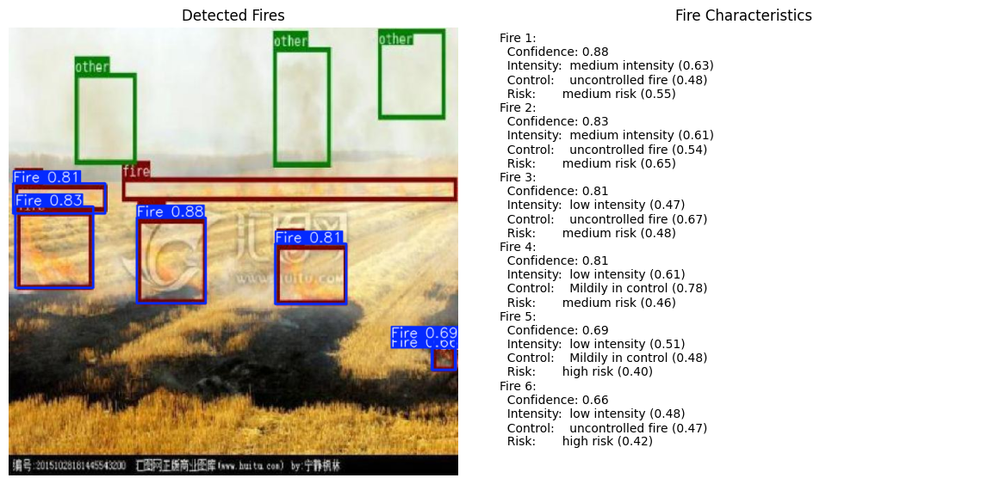


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2110-_jpg.rf.54b8ff3a146fd42c911330d3f52223d4.jpg: 640x640 7 Fires, 14.8ms
Speed: 2.0ms preprocess, 14.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


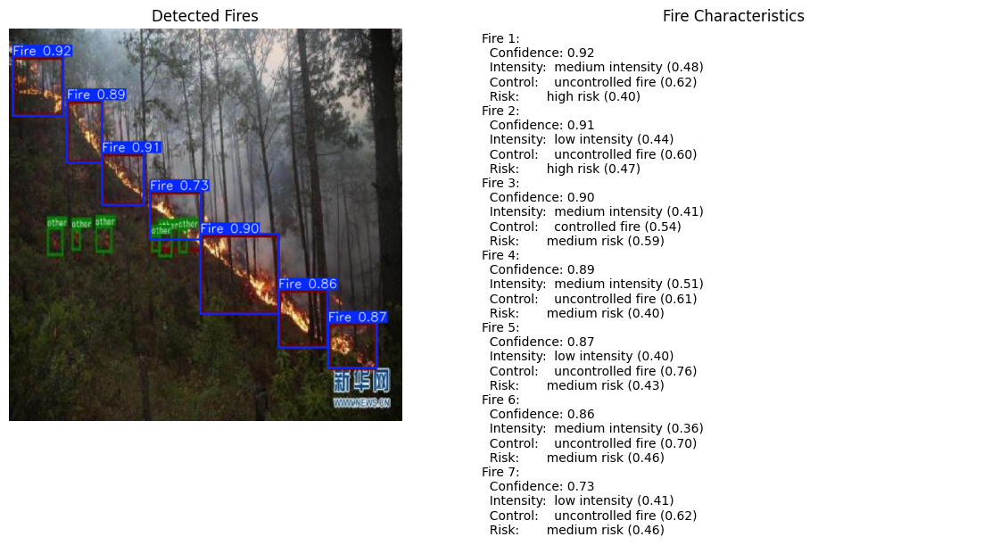


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_093_jpg.rf.545cf856f677ff8a7d7dad738e8da846.jpg: 640x640 1 Fire, 14.5ms
Speed: 1.8ms preprocess, 14.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


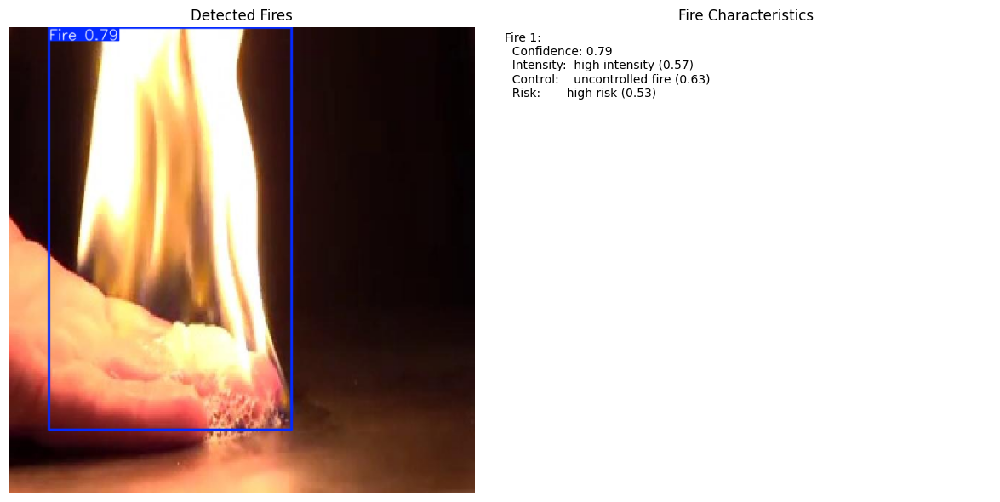


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-2401-_jpg.rf.205c8e17b5fa77e5d28cc546e25c1c83.jpg: 640x640 2 Fires, 14.5ms
Speed: 1.8ms preprocess, 14.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


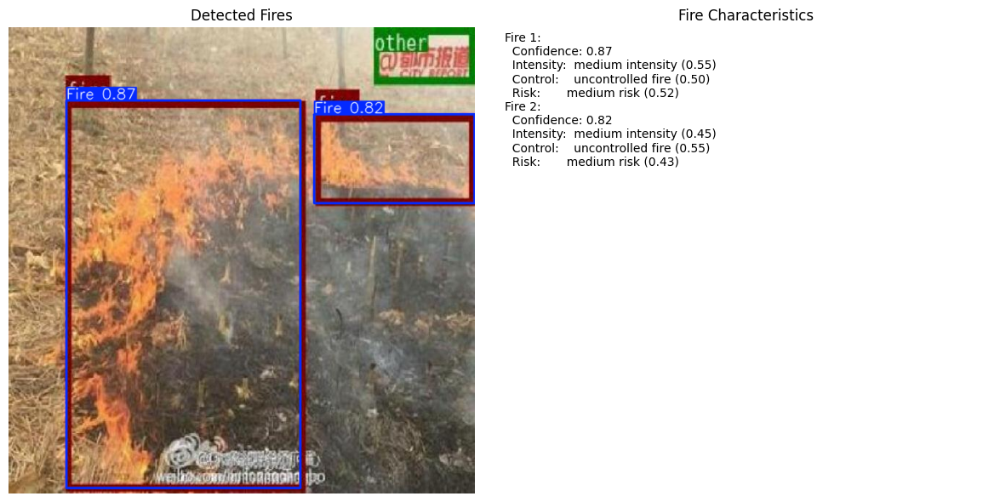


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_5_jpg.rf.7610cc53642f1bc6ffb3bf67adf96c1f.jpg: 640x640 (no detections), 16.3ms
Speed: 2.0ms preprocess, 16.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


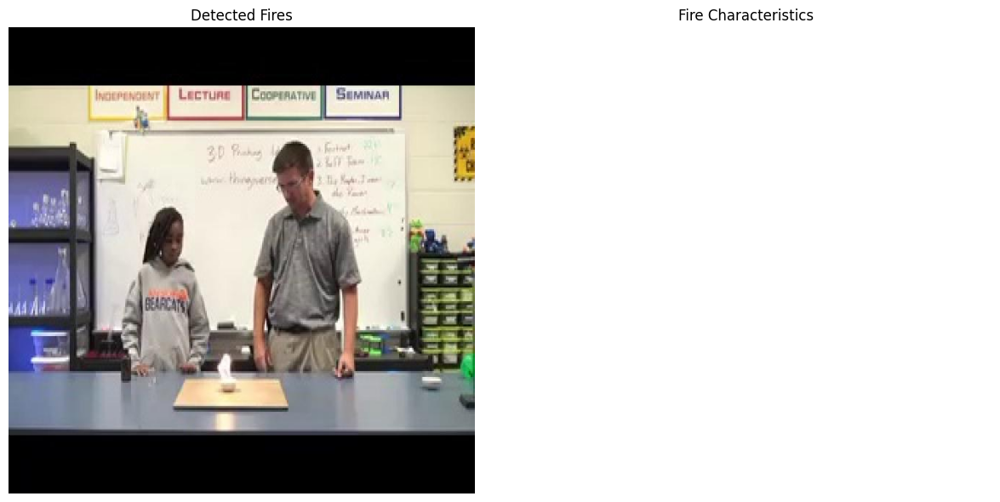


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-1934-_jpg.rf.dda3ea3232265fc02417042d0ddd95cd.jpg: 640x640 2 Fires, 2 Smokes, 16.3ms
Speed: 1.8ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


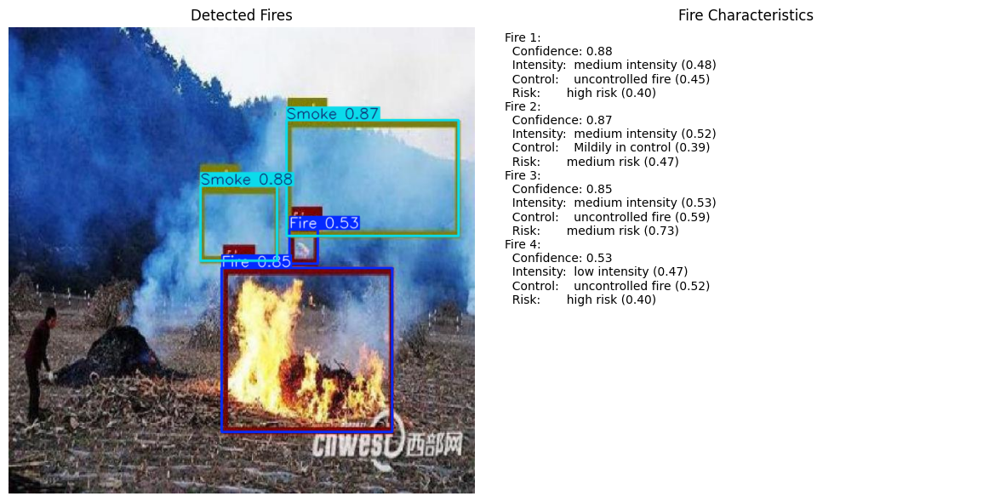


image 1/1 /kaggle/working/Fire-Detection-1/test/images/middle_-3934-_jpg.rf.291b057da33873802ef984f51859a4f4.jpg: 640x640 1 Fire, 1 Smoke, 15.3ms
Speed: 1.8ms preprocess, 15.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


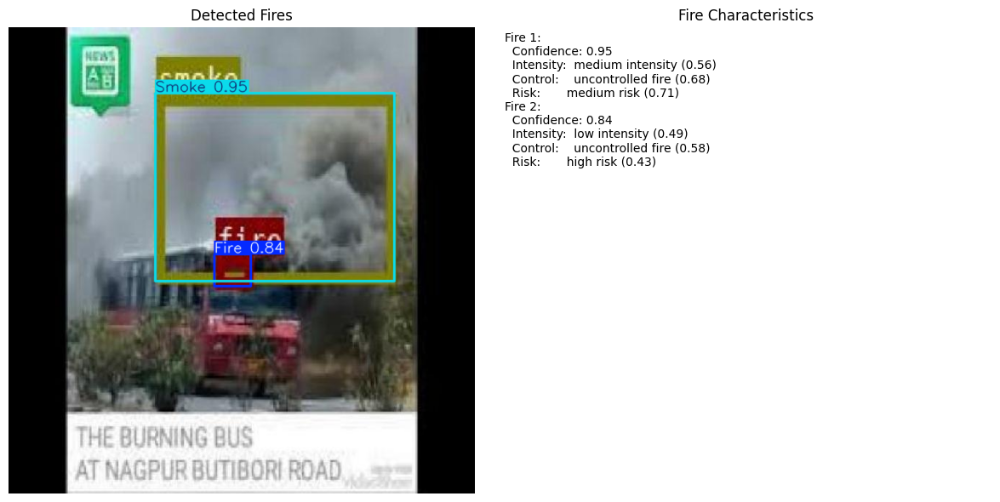


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_113_jpg.rf.4ebb7b9772a9ce179e48ba100db2c098.jpg: 640x640 (no detections), 15.4ms
Speed: 2.5ms preprocess, 15.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


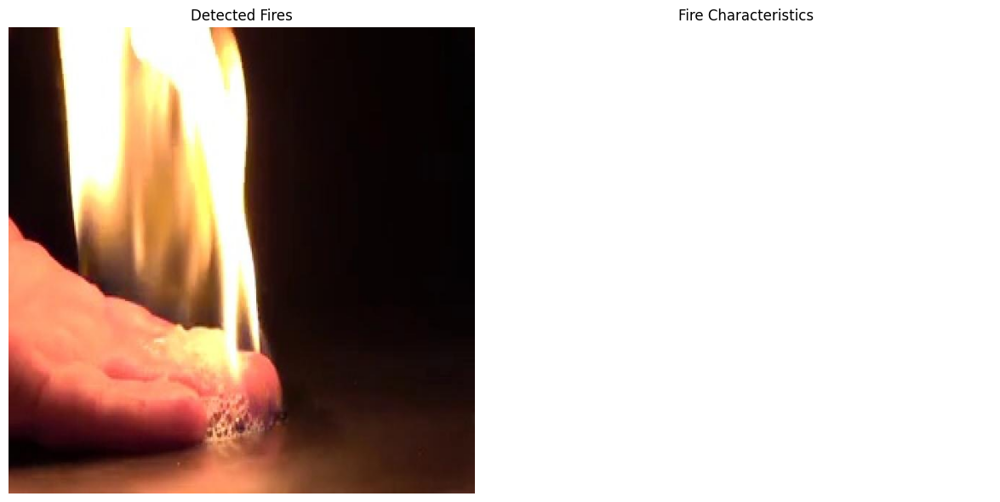


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_011_jpg.rf.a692decc64d225b4cf86408fd6336684.jpg: 640x640 1 Fire, 15.3ms
Speed: 2.5ms preprocess, 15.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


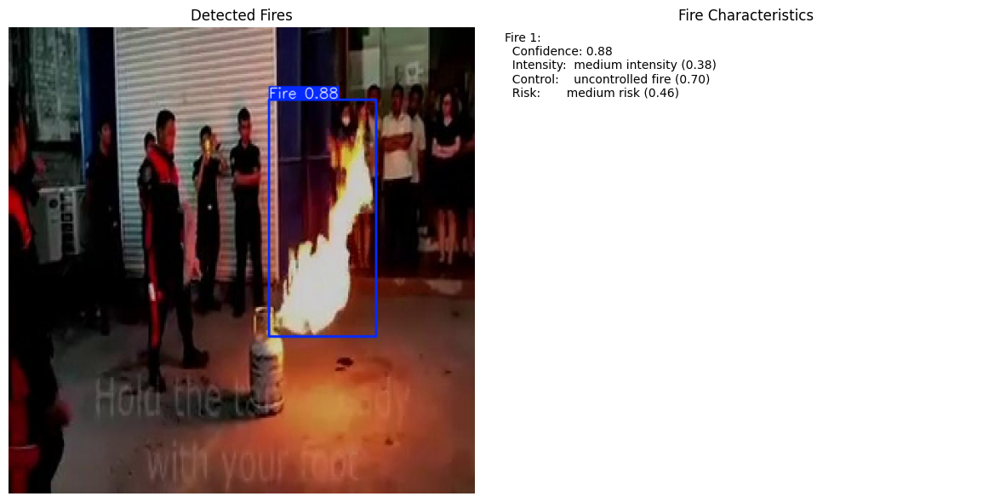


image 1/1 /kaggle/working/Fire-Detection-1/test/images/frame_204_jpg.rf.0430c7944047c4513318eb4eef99cbdc.jpg: 640x640 1 Fire, 15.9ms
Speed: 1.6ms preprocess, 15.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


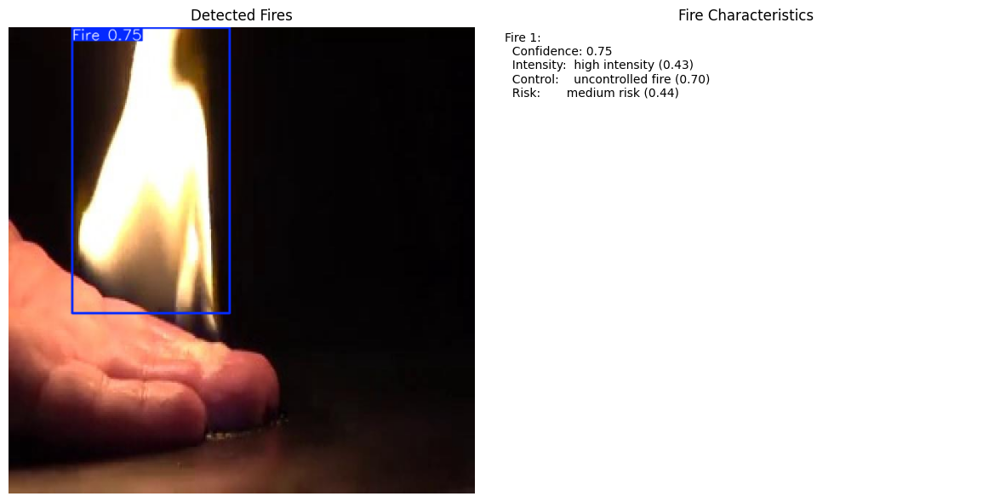

In [106]:
device = "cuda" if torch.cuda.is_available() else "cpu"

best_model = YOLO('/kaggle/working/runs/detect/fire_detection_small/weights/best.pt')
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
clip_model.to(device)

fire_prompts = {
    'intensity': [
        "a very small, contained fire, possibly just embers or a small flame",
        "a noticeable fire covering a moderate area, with visible flames and smoke",
        "a large, intense fire with significant flames, smoke, and potential for spreading"
    ],
    'control': [
        "a fire that is fully contained within a clear boundary, with active firefighting efforts visible",
        "a fire that is mostly contained but with some active flames or potential for spread",
        "an actively spreading wildfire with no visible containment efforts"
    ],
    'risk': [
        "a fire in a remote, unpopulated area posing minimal threat to people or property",
        "a fire burning near structures or infrastructure, posing a moderate threat",
        "a rapidly spreading fire directly threatening populated areas or critical infrastructure, requiring immediate action"
    ]
}

def analyze_fire_region(image_array):
    """Analyze a cropped fire region"""
    try:
        if image_array.max() <= 1.0:
            image_array = (image_array * 255).astype(np.uint8)
        image = Image.fromarray(image_array.astype(np.uint8))
        
        results = {}
        
        for characteristic, prompts in fire_prompts.items():
            inputs = processor(
                text=prompts,
                images=image,
                return_tensors="pt",
                padding=True,
                truncation=True
            ).to(device)
            
            with torch.no_grad():
                outputs = clip_model(**inputs)
                logits = outputs.logits_per_image
                probs = logits.softmax(dim=1).cpu().numpy()[0]
                
            results[characteristic] = {
                'prediction': prompts[np.argmax(probs)],
                'confidence': float(np.max(probs)),
                'all_probs': {p: float(v) for p, v in zip(prompts, probs)}
            }
        
        return results
    except Exception as e:
        print(f"Error in fire analysis: {e}")
        return None

base_path = "/kaggle/working/Fire-Detection-1"
test_images = glob(os.path.join(base_path, 'test', 'images', '*.jpg'))[:5] 

for img_path in random_images:

    results = best_model.predict(img_path, conf=0.5)
    img = Image.open(img_path).convert("RGB")

    analysis_text = []
    for i, box in enumerate(results[0].boxes):
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        crop = img.crop((x1, y1, x2, y2))

        inten_pred, inten_conf = classify_crop(crop, label_dict["intensity"])
        ctrl_pred,  ctrl_conf  = classify_crop(crop, label_dict["control"])
        risk_pred,  risk_conf  = classify_crop(crop, label_dict["risk"])

        analysis_text.append(f"Fire {i+1}:")
        analysis_text.append(f"  Confidence: {box.conf[0]:.2f}")
        analysis_text.append(f"  Intensity:  {inten_pred} ({inten_conf:.2f})")
        analysis_text.append(f"  Control:    {ctrl_pred} ({ctrl_conf:.2f})")
        analysis_text.append(f"  Risk:       {risk_pred} ({risk_conf:.2f})")

    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    res_plotted = results[0].plot()
    plt.imshow(res_plotted[..., ::-1])
    plt.axis('off')
    plt.title("Detected Fires")

    plt.subplot(1, 2, 2)

    plt.text(0.01, 0.99, "\n".join(analysis_text),
             va="top", fontsize=10)
    plt.axis('off')
    plt.title("Fire Characteristics")

    plt.tight_layout()
    plt.show()